# PROJECT: Delivering RIS (PP8)

## Check if GPU is available

In [1]:
from tensorflow.python.client import device_lib

def get_gpu_details():
    devices = device_lib.list_local_devices()
    for device in devices:
        if device.device_type == 'GPU':
            print(f"Device Name: {device.name}")
            print(f"Memory Limit: {device.memory_limit} bytes")
            print(f"Description: {device.physical_device_desc}")

get_gpu_details()


Device Name: /device:GPU:0
Memory Limit: 4158652416 bytes
Description: device: 0, name: NVIDIA GeForce GTX 1660 Ti with Max-Q Design, pci bus id: 0000:01:00.0, compute capability: 7.5


## Get Dataset

In [2]:
#!pip install tensorflow-datasets

In [3]:
import tensorflow_datasets as tfds

def describe_dataset(dataset_name: str) -> None:
    # Load the dataset with its information
    _, ds_info = tfds.load(name=dataset_name, with_info=True)
    
    # Print the dataset name and description
    print(f"Dataset Name: {ds_info.name}")
    print("Description:", ds_info.description)
    print("Homepage:", ds_info.homepage)
    print("Data directory:", ds_info.data_dir)
    print("Dataset size:", ds_info.dataset_size)
    print("Download size:", ds_info.download_size)
    print("File format:", ds_info.file_format)
    
    # Print the features of the dataset
    print("\nFeatures:")
    for feature, feature_info in ds_info.features.items():
        print(f"{feature}: {feature_info}")

    # Print information about each split (e.g., train, test)
    print("\nSplits:")
    for split, split_info in ds_info.splits.items():
        print(f"{split.capitalize()} split: {split_info.num_examples} examples")

    # Print the citation if available
    print("\nCitation:", ds_info.citation)

# Call the function with 'caltech101'
describe_dataset('caltech101')


C:\Users\tomui\anaconda3\envs\tensorflow_cuda_gpu_py310\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Dataset Name: caltech101
Description: Caltech-101 consists of pictures of objects belonging to 101 classes, plus one
`background clutter` class. Each image is labelled with a single object. Each
class contains roughly 40 to 800 images, totalling around 9k images. Images are
of variable sizes, with typical edge lengths of 200-300 pixels. This version
contains image-level labels only. The original dataset also contains bounding
boxes.
Homepage: https://doi.org/10.22002/D1.20086
Data directory: C:\Users\tomui\tensorflow_datasets\caltech101\3.0.2
Dataset size: 132.86 MiB
Download size: 131.05 MiB
File format: FileFormat.TFRECORD

Features:
image: Image(shape=(None, None, 3), dtype=uint8)
label: ClassLabel(shape=(), dtype=int64, num_classes=102)
image/file_name: Text(shape=(), dtype=string)

Splits:
Train split: 3059 examples
Test split: 6085 examples

Citation: @article{FeiFei2004LearningGV,
  title={Learning Generative Visual Models from Few Training Examples: An Incremental Bayesian Appr

In [4]:
# Load the dataset into a single dataset object and then split it manually
dataset = tfds.load('caltech101', split='all', as_supervised=True)

## Show samples

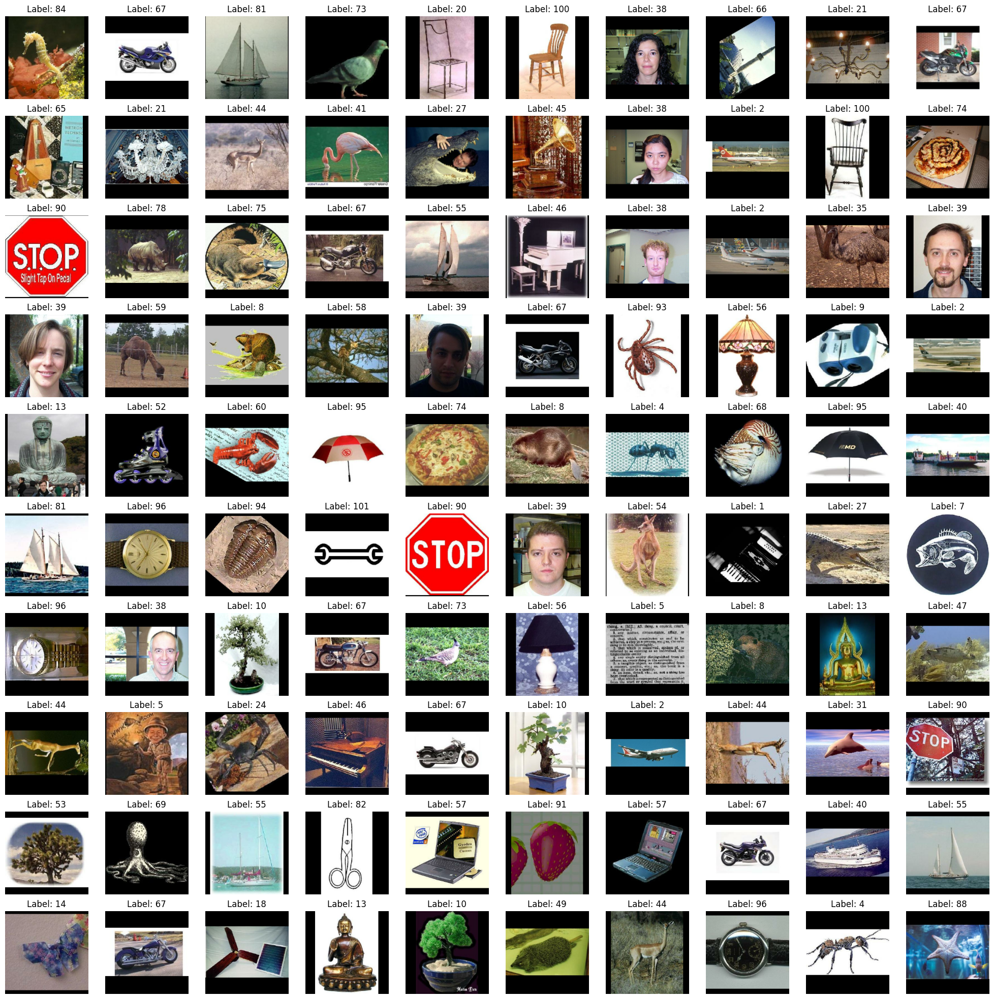

In [5]:
import tensorflow as tf
import matplotlib.pyplot as plt

# Collect 100 random samples
random_samples = dataset.shuffle(100).take(100)

def preprocess_image_2(image, label):
    image = tf.image.resize_with_pad(image, target_height=224, target_width=224)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

preprocessed_samples = random_samples.map(preprocess_image_2)

def show_images(images, labels):
    num_columns = 10
    num_rows = len(images) // num_columns

    plt.figure(figsize=(25, 25))

    for i, (image, label) in enumerate(zip(images, labels)):
        plt.subplot(num_rows, num_columns, i + 1)
        plt.imshow(image)
        plt.title(f"Label: {label + 1}")
        plt.axis('off')

    plt.show()

images_list, labels_list = zip(*preprocessed_samples.as_numpy_iterator())

show_images(images_list, labels_list)


## Split dataset

In [6]:
total_samples = dataset.cardinality().numpy()

train_size = int(0.8 * total_samples)
test_size = total_samples - train_size

train_dataset = dataset.take(train_size)
test_dataset = dataset.skip(train_size)

print(f"Training dataset size: {train_size}")
print(f"Test dataset size: {test_size}")

Training dataset size: 7315
Test dataset size: 1829


## Preproces images

In [7]:
import tensorflow as tf

def preprocess_image(image, label):
    image = tf.cast(image, tf.float32)
    image = tf.image.resize(image, [224, 224])
    return image, label

ds_train = train_dataset.map(preprocess_image)
ds_test = test_dataset.map(preprocess_image)

batch_size = 32
ds_train = ds_train.batch(batch_size)
ds_test = ds_test.batch(batch_size)

ds_train = ds_train.prefetch(tf.data.AUTOTUNE)
ds_test = ds_test.prefetch(tf.data.AUTOTUNE)


## Check representation of labels with image counts

In [8]:
def collect_labels(dataset):
    labels = []
    for _, label in dataset:
        labels.extend(label.numpy().tolist()) 
    return labels

train_labels = collect_labels(ds_train)
test_labels = collect_labels(ds_test)

def count_labels_tf(labels):
    labels_tensor = tf.constant(labels)
    unique, idx, count = tf.unique_with_counts(labels_tensor)
    return dict(zip(unique.numpy(), count.numpy()))

train_label_counts_tf = count_labels_tf(train_labels)
test_label_counts_tf = count_labels_tf(test_labels)

print("Train label counts with TensorFlow:", train_label_counts_tf)
print(len(train_label_counts_tf))
print("Test label counts with TensorFlow:", test_label_counts_tf)
print(len(test_label_counts_tf))

Train label counts with TensorFlow: {70: 46, 10: 73, 51: 30, 7: 41, 87: 68, 79: 35, 94: 62, 54: 85, 99: 50, 83: 48, 26: 41, 39: 54, 60: 53, 32: 62, 8: 32, 67: 46, 4: 347, 89: 50, 66: 578, 73: 50, 9: 97, 75: 50, 37: 316, 17: 46, 38: 324, 19: 52, 57: 138, 93: 63, 52: 47, 47: 39, 43: 32, 92: 44, 49: 66, 30: 50, 71: 35, 55: 51, 64: 32, 101: 51, 58: 66, 56: 65, 95: 180, 1: 567, 0: 50, 63: 73, 72: 44, 23: 61, 16: 98, 20: 81, 74: 34, 80: 58, 59: 38, 25: 45, 35: 54, 45: 76, 91: 65, 77: 50, 40: 57, 65: 60, 98: 34, 90: 34, 53: 68, 29: 45, 15: 37, 44: 46, 12: 68, 34: 49, 6: 48, 3: 37, 42: 33, 36: 73, 84: 32, 46: 79, 100: 37, 81: 38, 13: 77, 48: 43, 28: 53, 31: 52, 68: 32, 85: 53, 88: 49, 33: 50, 61: 38, 82: 74, 27: 50, 96: 36, 97: 49, 76: 64, 22: 52, 2: 38, 14: 43, 11: 39, 5: 43, 18: 48, 86: 39, 78: 42, 24: 58, 69: 38, 62: 39, 50: 69, 41: 39, 21: 44}
102
Test label counts with TensorFlow: {38: 111, 100: 2, 1: 233, 40: 10, 37: 119, 45: 23, 30: 15, 93: 23, 10: 25, 66: 220, 49: 22, 57: 62, 31: 16, 6

In [9]:
import numpy as np

# Calculate statistical information for train and test distributions
train_values = np.array(list(train_label_counts_tf.values()))
test_values = np.array(list(test_label_counts_tf.values()))

print("Train Distribution Statistics:")
print("Mean:", np.mean(train_values))
print("Median:", np.median(train_values))
print("Std Dev:", np.std(train_values))

print("\nTest Distribution Statistics:")
print("Mean:", np.mean(test_values))
print("Median:", np.median(test_values))
print("Std Dev:", np.std(test_values))

# Find classes with low representation
low_threshold = 5  # Threshold for considering a class underrepresented
underrepresented_train = {k: v for k, v in train_label_counts_tf.items() if v < low_threshold}
underrepresented_test = {k: v for k, v in test_label_counts_tf.items() if v < low_threshold}

print("\nUnderrepresented Classes in Training Data:", underrepresented_train)
print("Underrepresented Classes in Testing Data:", underrepresented_test)


Train Distribution Statistics:
Mean: 71.7156862745098
Median: 50.0
Std Dev: 87.2992798581106

Test Distribution Statistics:
Mean: 18.474747474747474
Median: 10.0
Std Dev: 36.33245576764593

Underrepresented Classes in Training Data: {}
Underrepresented Classes in Testing Data: {100: 2, 62: 1, 47: 3, 59: 3, 11: 4, 69: 1, 73: 3, 2: 4, 43: 2, 34: 4, 21: 3, 5: 4, 84: 3, 8: 1, 71: 3, 51: 1, 17: 1, 96: 1, 68: 3, 42: 1, 81: 1, 70: 1, 90: 1, 72: 1}


## Building the Model Using EfficientNetB0

In [10]:
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import EfficientNetB0

def build_model(num_classes: int):

    base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    base_model.trainable = False

    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.7)(x)
    predictions = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=predictions)

    optimizer = Adam(learning_rate=0.0001)

    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

model = build_model(102)  # 102: 101 + background class


## Set Up Callbacks

In [11]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

early_stopping = EarlyStopping(
    monitor='val_loss', 
    patience=20, 
    verbose=1,
    restore_best_weights=True
)

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss', 
    factor=0.1,
    patience=7, 
    verbose=1
)

callbacks = [early_stopping, reduce_lr]


## Training the Model

In [12]:
epochs = 200

history = model.fit(
    ds_train,
    epochs=epochs,
    validation_data=ds_test,
    callbacks=callbacks
)


Epoch 1/200
229/229 [==============================] - 34s 93ms/step - loss: 3.2071 - accuracy: 0.3594 - val_loss: 1.5120 - val_accuracy: 0.7944 - lr: 1.0000e-04
Epoch 2/200
229/229 [==============================] - 19s 83ms/step - loss: 1.6368 - accuracy: 0.7189 - val_loss: 0.6663 - val_accuracy: 0.9224 - lr: 1.0000e-04
Epoch 3/200
229/229 [==============================] - 19s 84ms/step - loss: 0.8971 - accuracy: 0.8433 - val_loss: 0.3783 - val_accuracy: 0.9415 - lr: 1.0000e-04
Epoch 4/200
229/229 [==============================] - 20s 85ms/step - loss: 0.5777 - accuracy: 0.8869 - val_loss: 0.2768 - val_accuracy: 0.9535 - lr: 1.0000e-04
Epoch 5/200
229/229 [==============================] - 22s 95ms/step - loss: 0.4348 - accuracy: 0.9064 - val_loss: 0.2296 - val_accuracy: 0.9584 - lr: 1.0000e-04
Epoch 6/200
229/229 [==============================] - 22s 97ms/step - loss: 0.3580 - accuracy: 0.9213 - val_loss: 0.2040 - val_accuracy: 0.9574 - lr: 1.0000e-04
Epoch 7/200
229/229 [=======

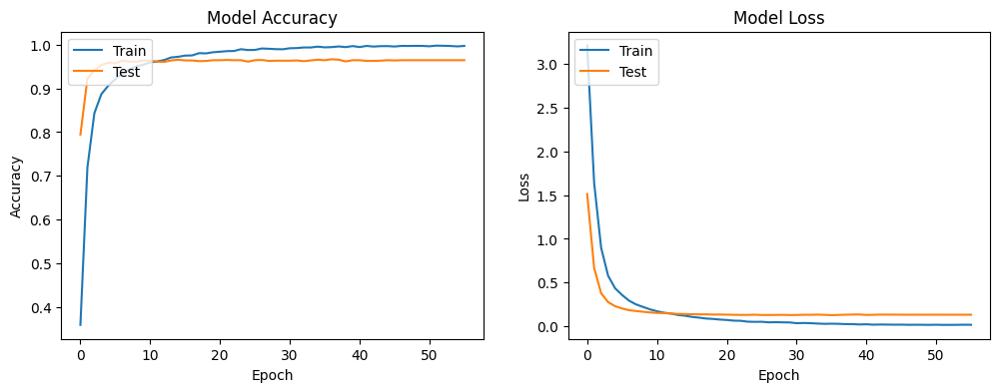

In [13]:
import matplotlib.pyplot as plt

def plot_training_history(history):
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))

    # Plot training & validation accuracy values
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_xlabel('Epoch')
    ax[0].legend(['Train', 'Test'], loc='upper left')

    # Plot training & validation loss values
    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('Epoch')
    ax[1].legend(['Train', 'Test'], loc='upper left')

    plt.show()

plot_training_history(history)

## Model Evaluation Metrics

In [14]:
test_loss, test_accuracy = model.evaluate(ds_test)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")


58/58 [==============================] - 21s 356ms/step - loss: 0.1273 - accuracy: 0.9645
Test Loss: 0.12725886702537537
Test Accuracy: 0.9644614458084106


In [15]:
#!pip install scikit-learn

In [16]:
from sklearn.metrics import classification_report

# Collect all labels and predictions
y_true = np.array([])
y_pred = []

for images, labels in ds_test:
    preds = model.predict(images, verbose=0)
    y_pred.extend(preds)
    y_true = np.concatenate([y_true, labels.numpy()])

y_pred = np.array(y_pred)
y_pred_classes = np.argmax(y_pred, axis=1)

# Print classification report
print(classification_report(y_true, y_pred_classes, zero_division=0))


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         5
         1.0       1.00      1.00      1.00       233
         2.0       0.57      1.00      0.73         4
         3.0       0.71      1.00      0.83         5
         4.0       0.89      0.83      0.86       120
         5.0       1.00      1.00      1.00         4
         6.0       0.83      0.83      0.83         6
         7.0       0.83      1.00      0.91         5
         8.0       1.00      1.00      1.00         1
         9.0       1.00      1.00      1.00        31
        10.0       1.00      0.96      0.98        25
        11.0       0.80      1.00      0.89         4
        12.0       1.00      1.00      1.00        17
        13.0       1.00      1.00      1.00        14
        14.0       1.00      1.00      1.00         7
        15.0       1.00      0.83      0.91         6
        16.0       1.00      1.00      1.00        25
        17.0       1.00    

## Save Model

In [17]:
# # TensorFlow 2.10 for save of EfficientNetB0 model throws errors, bug fixed in later TensorFlow versions. TensorFlow 2.10 installed with purpose of using GPU on Windows
# from tensorflow.keras.models import save_model
# save_model(model, "model.h5")


In [18]:
#!pip install matplotlib

## Find Layer for Feature Extraction

In [19]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['input_1[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 224, 224, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 rescaling_1 (Rescaling)        (None, 224, 224, 3)  0           ['normalization[0][0]']      

# Experiment RIS from here

## Feature Extraction

In [20]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import random

# Define a function to preprocess images
def preprocess_image(image, label):
    image = tf.cast(image, tf.float32)
    image = tf.image.resize(image, [224, 224])
    return image, label

# Load the dataset and apply preprocessing
dataset_original = tfds.load('caltech101', split='all', as_supervised=True)
dataset = dataset_original.map(preprocess_image)

# Batch and prefetch the dataset
batch_size = 32
dataset = dataset.batch(batch_size)
dataset = dataset.prefetch(tf.data.AUTOTUNE)

feature_extractor = tf.keras.Model(inputs=model.input, outputs=model.get_layer('global_average_pooling2d').output)

# Extract features from the dataset
def extract_features(dataset):
    features = []
    labels = []
    for images, batch_labels in dataset:
        batch_features = feature_extractor(images)
        features.extend(batch_features.numpy())
        labels.extend(batch_labels.numpy())
    return np.array(features), np.array(labels)

# Extract features
features, labels = extract_features(dataset)

## Save Features

In [21]:
np.save('features.npy', features)
np.save('labels.npy', labels)
print("Image feature data saved")

Image feature data saved


## Load Features

In [22]:
import numpy as np
from numpy.typing import NDArray
from typing import Any

features: NDArray[Any] = np.load('features.npy')
labels: NDArray[Any] = np.load('labels.npy')
print("Image feature data loaded")

Image feature data loaded


## Nearest Neighbors

Nearest Neighbors indices: [[8663 5211 5329 6161 5046 2942 7824 1835 8159 4446]]
Distances: [[0.         4.70049582 5.57988127 5.8119536  5.99321184 6.05578526
  6.29007189 6.30039991 6.30376158 6.41923971]]


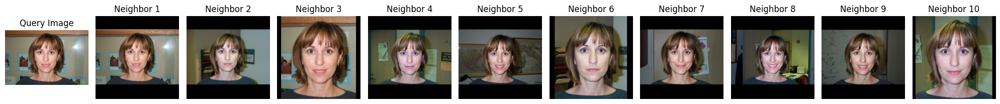

Nearest Neighbors indices: [[7948 2358 2494  343 5305 8051 3184 7788 3167 5879]]
Distances: [[0.         4.02282181 5.73244537 6.37024295 6.65750127 6.65753843
  6.76954652 6.92242124 6.98386965 7.02003497]]


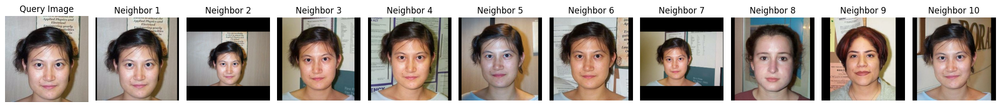

Nearest Neighbors indices: [[5262 5279 2029 4467 7081 7024 4605 6306 3794 6667]]
Distances: [[0.         6.87449534 6.88372452 6.89509519 6.98125088 6.98242729
  6.99154929 6.99210772 7.02037916 7.0903808 ]]


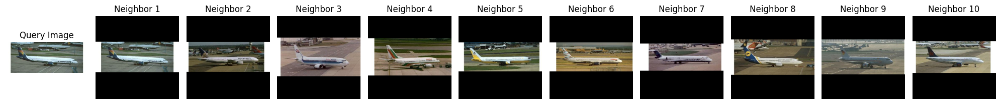

Nearest Neighbors indices: [[7828  443 3090  465 5138 7567 1238  364 6536 8204]]
Distances: [[0.         5.35630386 5.63775985 6.59652665 6.79581542 7.15974072
  7.24130045 7.291847   7.55026642 7.60406861]]


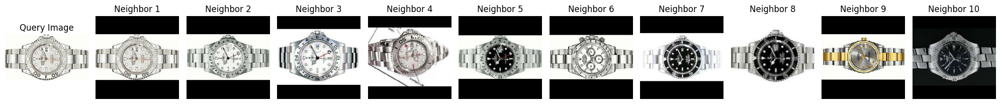

Nearest Neighbors indices: [[4218 4820 6122 5207  756 8139 6155 8749 6535 7724]]
Distances: [[ 0.         10.45595645 10.51101565 10.58388204 10.83613313 10.99414784
  11.17358602 11.19069688 11.22508871 11.32685999]]


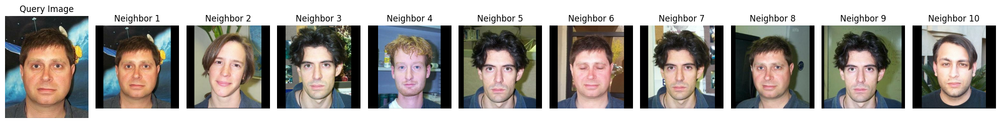

Nearest Neighbors indices: [[8021 9109 5520 7201 3493 1101 2702 6935   33 8476]]
Distances: [[0.         4.73082144 4.84931945 5.45811434 5.56019929 5.56797456
  5.7601361  5.76246133 5.79757681 5.85049539]]


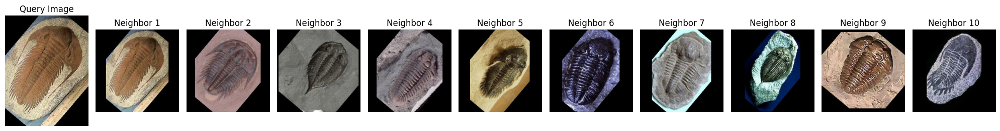

Nearest Neighbors indices: [[5694  366 1408 3781  834  801 4718 3845 2276 2157]]
Distances: [[ 0.          9.34705156  9.86749973 10.30014122 10.63759835 10.84057465
  10.88753101 11.45442894 11.46698583 12.1707653 ]]


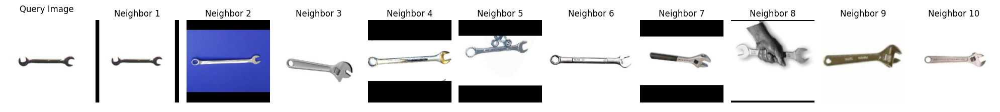

Nearest Neighbors indices: [[5552 5704 1172 1934 4582 9053 1089 2374 3111 7027]]
Distances: [[0.         8.67789964 9.052193   9.07381367 9.14041194 9.16485478
  9.19782448 9.31498343 9.42663439 9.511777  ]]


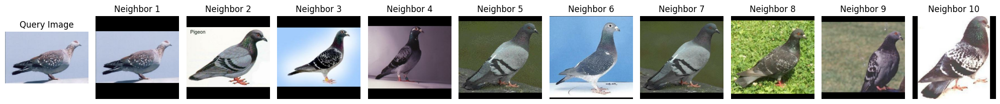

Nearest Neighbors indices: [[1349  309 6275 6630 2203 5153 3689 8015 6410 7078]]
Distances: [[0.         7.17802733 7.69372017 7.84761907 7.85173447 7.93237979
  8.10706827 8.27977163 8.38033024 8.54730416]]


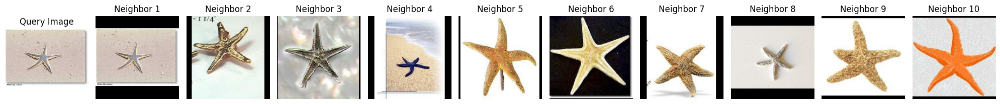

Nearest Neighbors indices: [[5782 1137 5305 4573 1881 6479 8157 8052  472 5879]]
Distances: [[0.         5.8634954  5.8858951  6.19352678 6.22083114 7.31736883
  7.51616303 7.56035399 7.56363627 7.58590804]]


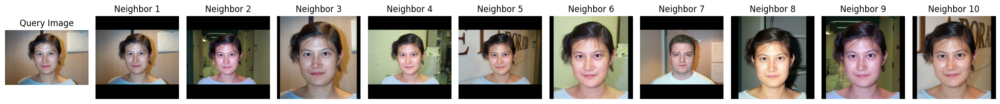

In [23]:
# Train the Nearest Neighbors model
nn = NearestNeighbors(n_neighbors=10, algorithm='ball_tree')
nn.fit(features)

def preprocess_image_2(image, label):
    image = tf.image.resize_with_pad(image, target_height=224, target_width=224)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

# Select random query images
random_query_images = random.sample(range(len(features)), 10)

# Find nearest neighbors for each query image and visualize
for query_index in random_query_images:
    distances, neighbor_indices = nn.kneighbors([features[query_index]])
    print("Nearest Neighbors indices:", neighbor_indices)
    print("Distances:", distances)
        
    # Get the actual images corresponding to the neighbor indices and resize them
    neighbor_images = []
    for index in neighbor_indices[0]:
        image, _ = next(iter(dataset_original.skip(index).take(1)))
        resized_image = preprocess_image_2(image, None)[0]
        neighbor_images.append(resized_image)

    # Define a function to visualize images
    def visualize_images(query_image, neighbor_images):
        # Display the query image
        plt.figure(figsize=(20, 5))
        plt.subplot(1, len(neighbor_images) + 1, 1)
        plt.imshow(query_image)  # Display the query image
        plt.title('Query Image')
        plt.axis('off')
    
        # Display images of nearest neighbors
        for i, image in enumerate(neighbor_images, start=2):
            plt.subplot(1, len(neighbor_images) + 1, i)
            plt.imshow(image)  # Display the neighbor image
            plt.title(f'Neighbor {i-1}')
            plt.axis('off')
    
        plt.tight_layout()
        plt.show()
    
    # Call the visualization function
    visualize_images(next(iter(dataset_original.skip(query_index).take(1)))[0], neighbor_images)

## Cosine Similarity

Nearest Neighbors indices: [8663 5211 5329 6161 5046 2942 1835 7824 8159 4446]


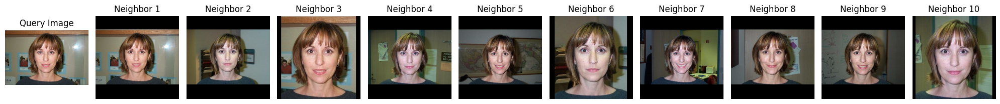

Nearest Neighbors indices: [7948 2358 2494 8051  343 3184 3167 5305 1495 7788]


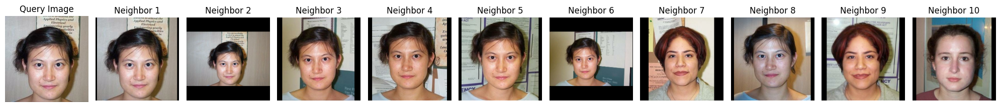

Nearest Neighbors indices: [5262 2029 7024 5279 4605 4467 7123 2680 7081 5436]


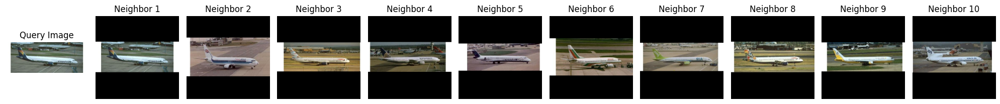

Nearest Neighbors indices: [7828  443 3090 7567  465 5138 6536  364 1238  701]


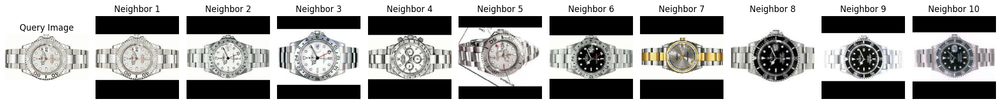

Nearest Neighbors indices: [4218 5207 4820 7860 6122 8511  859  756 8567 6155]


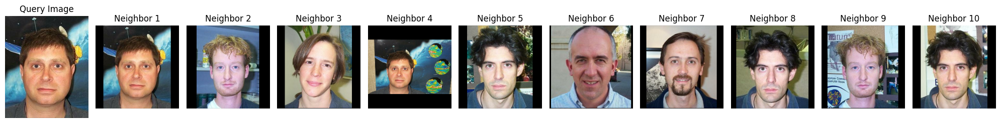

Nearest Neighbors indices: [8021 9109 5520 7201 3493 1101 6935 2702 7807   33]


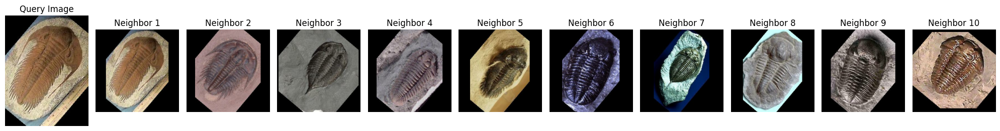

Nearest Neighbors indices: [5694  366 1408 3781  834  801 4718 4879 2276 3845]


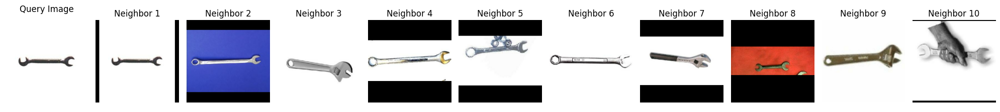

Nearest Neighbors indices: [5552 1172 1934 5704  585 2184 5095 3629 7027 3111]


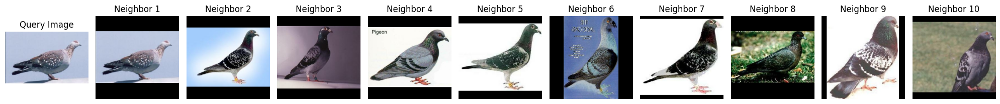

Nearest Neighbors indices: [1349  309 2203 6630 6275 5153 3689 8015 6410 4708]


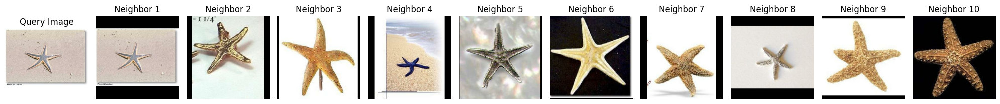

Nearest Neighbors indices: [5782 1137 5305 1881 4573 8157 6479 6126 2358 8058]


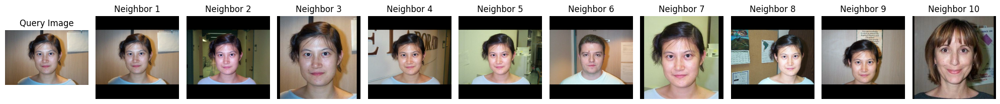

In [24]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Compute cosine similarity between query images and dataset images
cosine_similarities = cosine_similarity(features, features)

# Find nearest neighbors for each query image
num_neighbors = 10 
nearest_neighbors_indices = np.argsort(-cosine_similarities, axis=1)[:, :num_neighbors]

# Find nearest neighbors for each query image and visualize
for query_index in random_query_images:
    neighbor_indices = nearest_neighbors_indices[query_index]
    print("Nearest Neighbors indices:", neighbor_indices)
   
    # Get the actual images corresponding to the neighbor indices and resize them
    neighbor_images = []
    for index in neighbor_indices:
        image, _ = next(iter(dataset_original.skip(index).take(1)))
        resized_image = preprocess_image_2(image, None)[0] 
        neighbor_images.append(resized_image)

    # Define a function to visualize images
    def visualize_images(query_image, neighbor_images):
        # Display the query image
        plt.figure(figsize=(20, 5))
        plt.subplot(1, len(neighbor_images) + 1, 1)
        plt.imshow(query_image)  # Display the query image
        plt.title('Query Image')
        plt.axis('off')
    
        # Display images of nearest neighbors
        for i, image in enumerate(neighbor_images, start=2):
            plt.subplot(1, len(neighbor_images) + 1, i)
            plt.imshow(image)  # Display the neighbor image
            plt.title(f'Neighbor {i-1}')
            plt.axis('off')
    
        plt.tight_layout()
        plt.show()
    
    # Call the visualization function
    visualize_images(next(iter(dataset_original.skip(query_index).take(1)))[0], neighbor_images)

## Visualize the Feature Distribution

## PCA

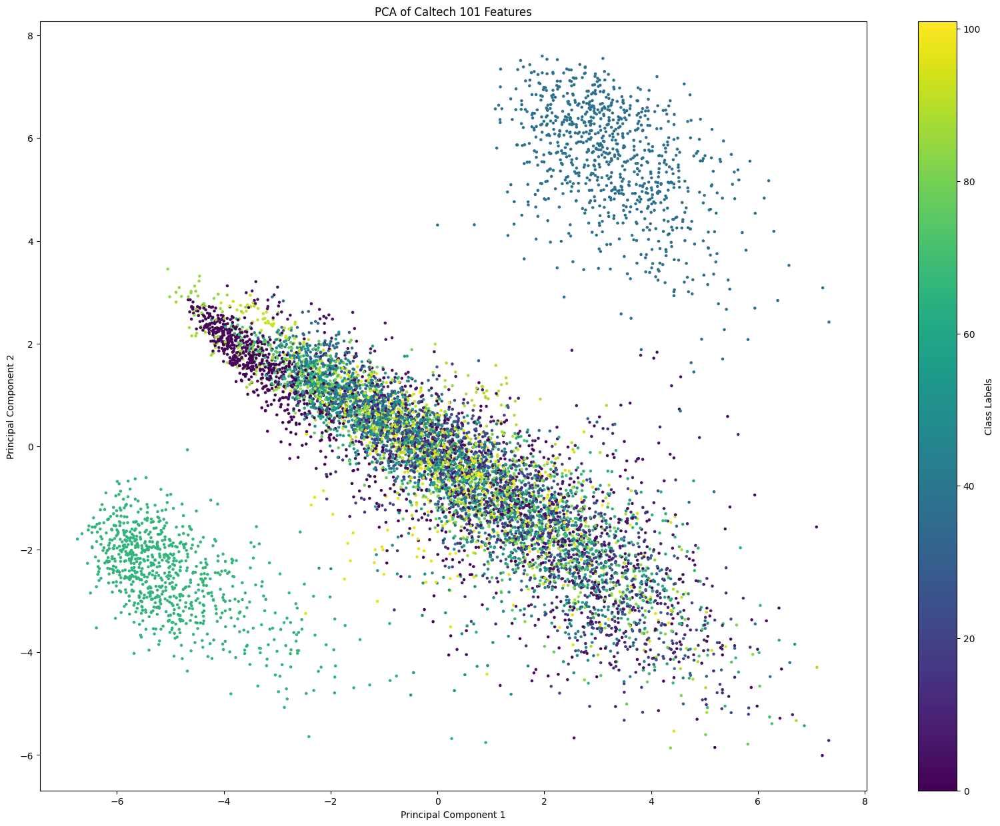

In [25]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

features: np.ndarray = np.load('features.npy')
labels: np.ndarray = np.load('labels.npy')

pca = PCA(n_components=2)
reduced_features = pca.fit_transform(features)

plt.figure(figsize=(20,15))
plt.scatter(reduced_features[:, 0], reduced_features[:, 1], c=labels, cmap='viridis', s=5)
plt.colorbar(label='Class Labels')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Caltech 101 Features')
plt.show()


## t-SNE

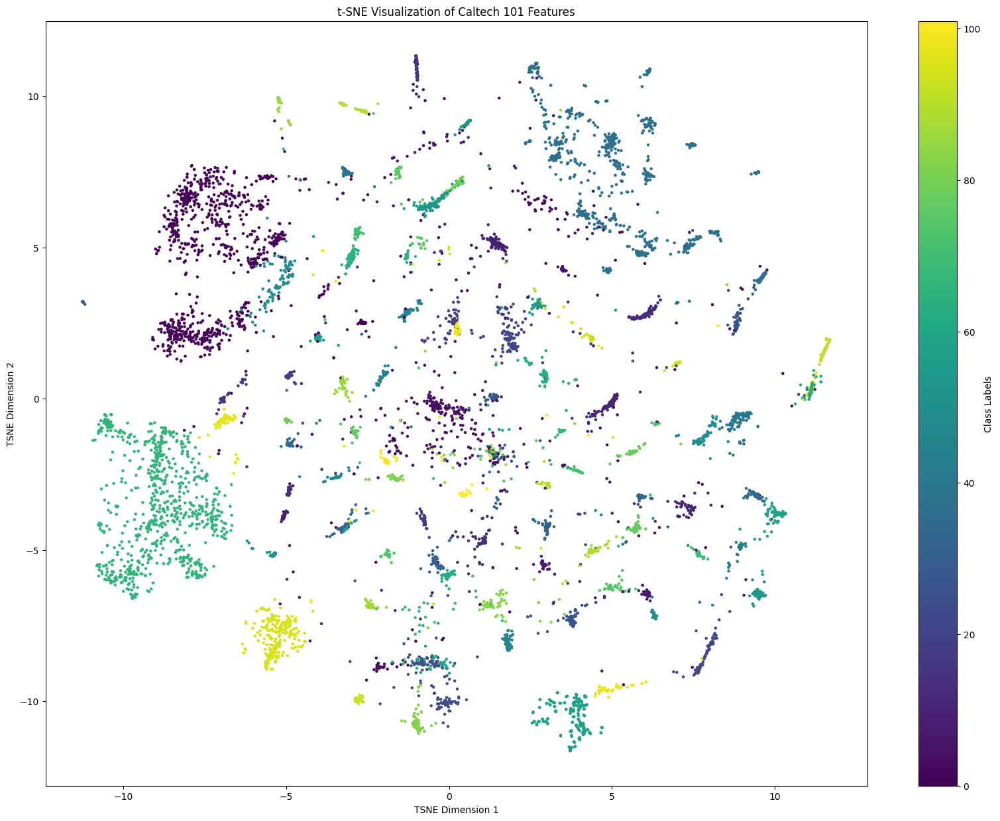

In [26]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
tsne_features = tsne.fit_transform(features)

plt.figure(figsize=(20,15))
plt.scatter(tsne_features[:, 0], tsne_features[:, 1], c=labels, cmap='viridis', s=5)
plt.colorbar(label='Class Labels')
plt.xlabel('TSNE Dimension 1')
plt.ylabel('TSNE Dimension 2')
plt.title('t-SNE Visualization of Caltech 101 Features')
plt.show()


## Box Plot: First Feature across different classes

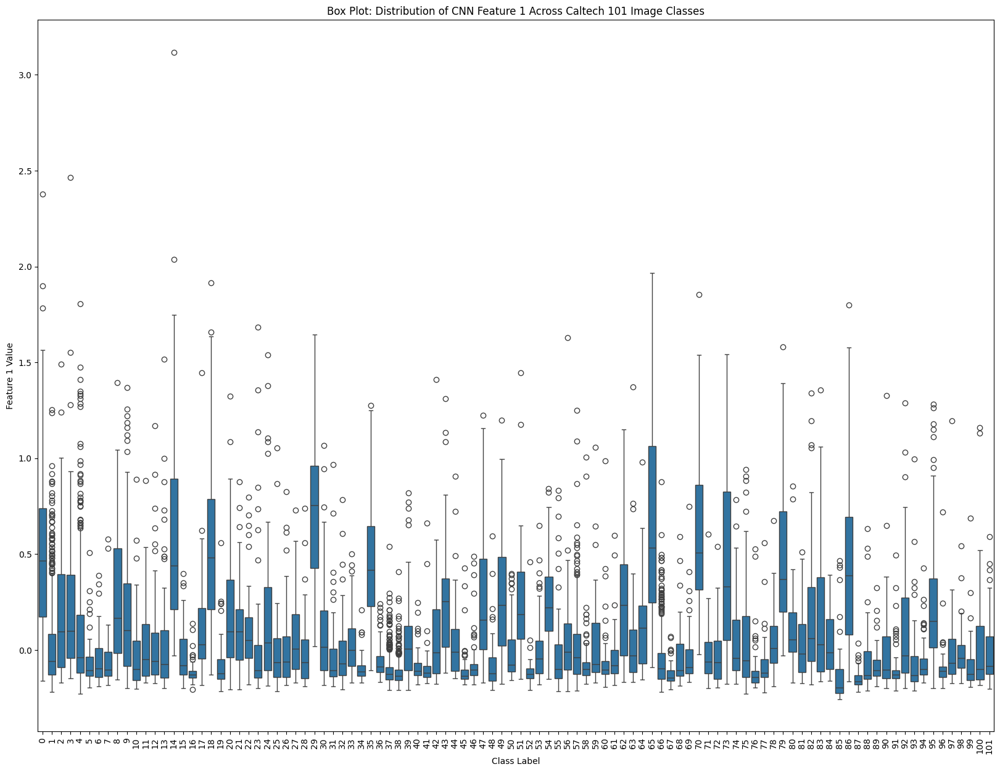

In [27]:
import seaborn as sns

plt.figure(figsize=(20, 15))
sns.boxplot(x=labels, y=features[:, 0])
plt.xlabel('Class Label')
plt.ylabel('Feature 1 Value')
plt.title('Box Plot: Distribution of CNN Feature 1 Across Caltech 101 Image Classes')
plt.xticks(rotation=90)
plt.show()


## Visualize the patterns in the images using t-SNE (2000 images)

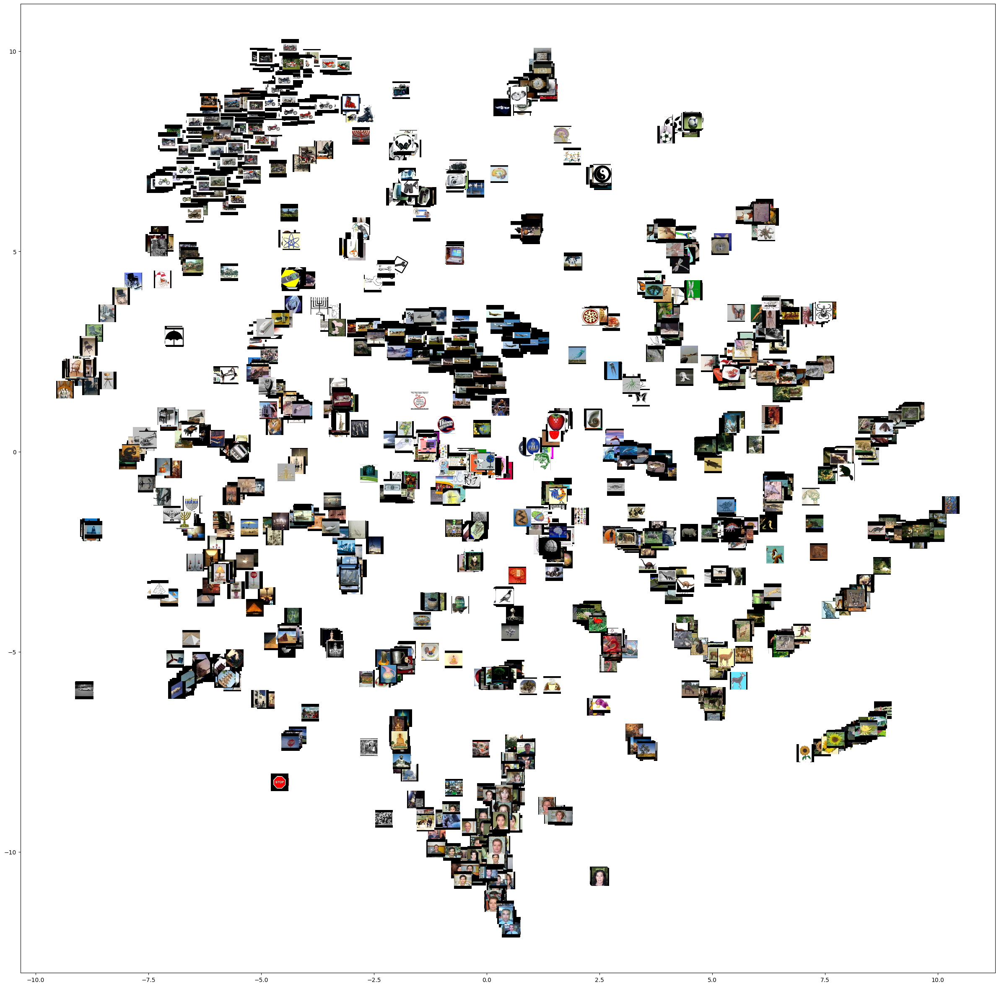

In [28]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image, ImageOps

def load_and_preprocess_image(index, dataset):
    image, _ = next(iter(dataset.skip(index).take(1)))
    processed_image = preprocess_image_2(image, None)[0]
    img_array = processed_image.numpy() if isinstance(processed_image, tf.Tensor) else processed_image
    return Image.fromarray((img_array * 255).astype(np.uint8))

def plot_images_in_2d(x, y, images, axis=None, zoom=1):
    if axis is None:
        axis = plt.gca()
    x, y = np.atleast_1d(x, y)
    for x0, y0, img in zip(x, y, images):
        img = ImageOps.fit(img, (100, 100), Image.Resampling.LANCZOS)
        img = OffsetImage(img, zoom=zoom)
        anno_box = AnnotationBbox(img, (x0, y0), xycoords='data', frameon=False)
        axis.add_artist(anno_box)
    axis.update_datalim(np.column_stack([x, y]))
    axis.autoscale()

def show_tsne(features, dataset, num_images=2000, zoom=0.3, size=(22, 22)):

    tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
    tsne_results = tsne.fit_transform(features[:num_images])

    images = [load_and_preprocess_image(i, dataset) for i in range(num_images)]

    fig, axis = plt.subplots()
    fig.set_size_inches(size[0], size[1], forward=True)
    plot_images_in_2d(tsne_results[:, 0], tsne_results[:, 1], images, zoom=zoom, axis=axis)
    plt.show()

features = np.load('features.npy')
show_tsne(features, dataset_original, zoom=0.3, size=(30, 30))


# Search on new images

## Extract features of new images

In [29]:
import os

def load_and_preprocess_image(file_path: str) -> tf.Tensor:
    image = tf.io.read_file(file_path)
    image = tf.image.decode_image(image, channels=3, expand_animations=False)
    image = tf.image.resize(image, [224, 224])
    image = tf.cast(image, tf.float32)
    return image

folder_path = 'new_images'
image_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))]
images_set = tf.data.Dataset.from_tensor_slices(image_files)
images_set = images_set.map(load_and_preprocess_image)

batch_size = 32
images_set = images_set.batch(batch_size)
images_set = images_set.prefetch(tf.data.AUTOTUNE)

feature_extractor = tf.keras.Model(inputs=model.input, outputs=model.get_layer('global_average_pooling2d').output)

def extract_features(images: tf.data.Dataset) -> np.ndarray:
    features = []
    for batch_images in images:
        batch_features = feature_extractor(batch_images)
        features.extend(batch_features.numpy())
    return np.array(features)

new_images_features = extract_features(images_set)


Nearest Neighbors indices: [[7199  708 6479 5305 5879 3655 8141  472 3513 1598]]
Distances: [[9.40994017 9.4670323  9.48022409 9.49398567 9.63783491 9.64617387
  9.67549841 9.67643572 9.75209876 9.81806614]]


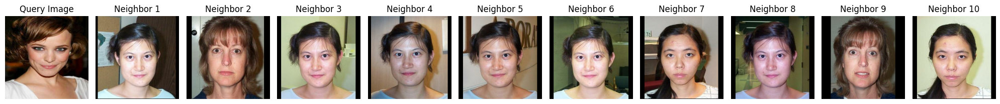

Nearest Neighbors indices: [[4123 4963 4721  332 3192 5990 5769 3022 8843 8647]]
Distances: [[ 9.50693887  9.57915414  9.997564   10.01693075 10.17555686 10.19030909
  10.26637044 10.32858741 10.3495599  10.61421632]]


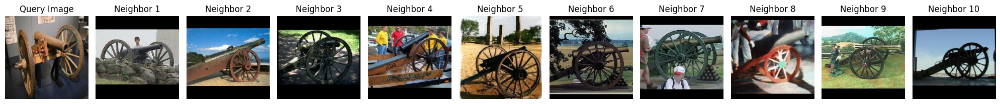

Nearest Neighbors indices: [[4462 4427 9053 7127 4422 3910 4582 1089 2374  784]]
Distances: [[ 8.57444357  8.89447598  9.78777652 10.05488519 10.15991952 10.26398636
  10.47547004 10.63894952 10.87163015 10.88249259]]


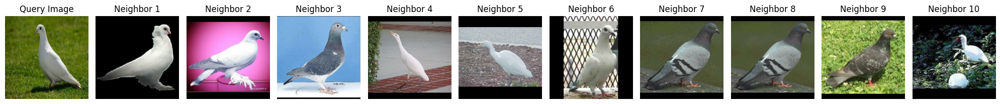

Nearest Neighbors indices: [[4602 5277 5463 6800 6761 4786 7514  982 7637 6009]]
Distances: [[10.48911042 10.66774006 11.04673599 11.06469625 11.14851163 11.19477361
  11.29646608 11.51912728 11.53185847 11.57428843]]


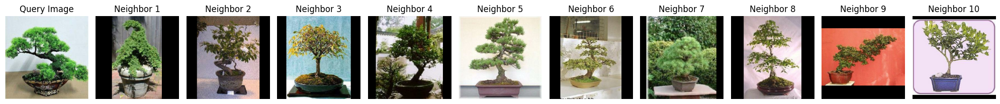

Nearest Neighbors indices: [[ 841 5686 3496 2261 7005 5738 2506 1234 3299 5327]]
Distances: [[6.84111286 7.43635944 7.87181304 8.08746353 8.12226856 8.41888064
  8.52013579 8.53391501 8.82203122 9.08640405]]


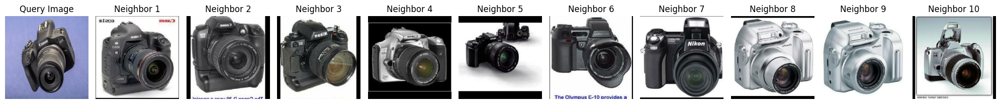

Nearest Neighbors indices: [[5777 1953 2662 3425 3570 2310 8362 1319 1780 3724]]
Distances: [[16.1964572  16.26118597 16.32852044 17.07666619 17.2242265  17.36471278
  17.4174617  17.52270923 17.52286387 17.60623497]]


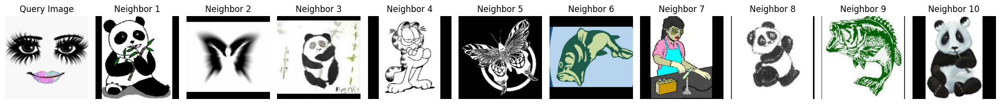

Nearest Neighbors indices: [[1598 3187 2494 7948 7926 3167 6479 5750 8052 7943]]
Distances: [[11.92841477 11.96375858 12.20083534 12.43779083 12.54980848 12.55555937
  12.58514407 12.66492873 12.67441808 12.6990579 ]]


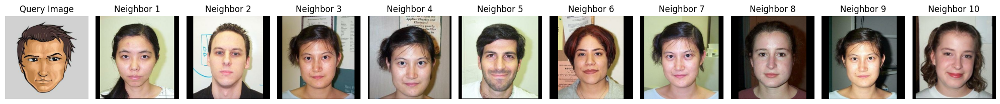

Nearest Neighbors indices: [[1598 5750 7948 6066 1394 1801 6984  157 5879 8052]]
Distances: [[7.74443618 7.8991355  7.93077494 8.27887376 8.33069565 8.33564694
  8.39738081 8.47786867 8.51539097 8.5818516 ]]


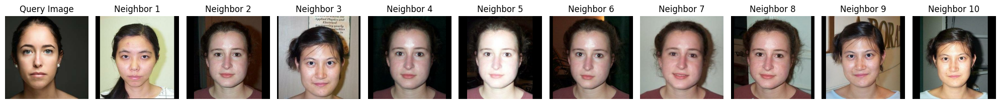

Nearest Neighbors indices: [[6984 6048 3347 2426 8276 6135 5750  157 5818 4533]]
Distances: [[5.18332419 5.36375648 5.86381757 5.92286051 6.00680091 6.08035437
  6.44702666 6.49283137 6.50451307 6.61829297]]


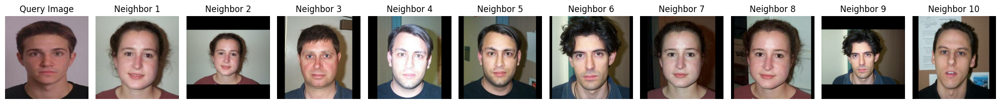

Nearest Neighbors indices: [[3187 8938 4950 5989 9040 7926 7908 9002 8107 6535]]
Distances: [[10.04478732 10.56271291 10.66761559 10.78473919 10.82351293 10.82998735
  10.98684218 10.98860114 11.0470515  11.05475528]]


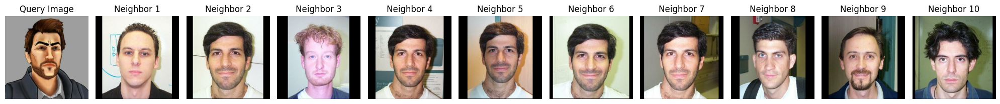

Nearest Neighbors indices: [[3897 8335 1598 1909  708 5305 4820 9044 8141 1495]]
Distances: [[ 9.70404138  9.91911703 10.06898906 10.07124384 10.07312695 10.08208315
  10.1927597  10.21070569 10.26509293 10.47067637]]


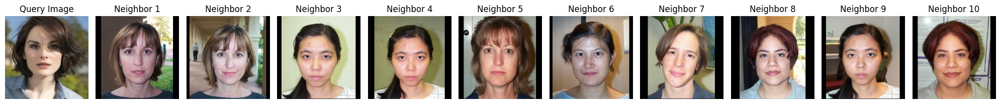

Nearest Neighbors indices: [[6535 6074 7746 4950 4348 9002 8329 1015 4976 6520]]
Distances: [[10.68743995 10.69527498 10.78490753 10.80369512 10.80491361 10.82465574
  10.87489247 10.88206325 10.95612576 10.97216967]]


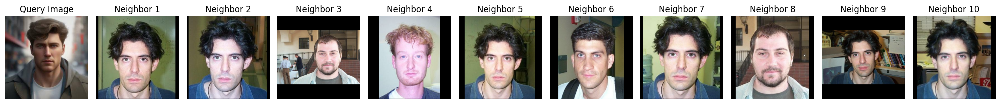

Nearest Neighbors indices: [[3716 6118 4577   13 1794 2553 1496 8963 6249  704]]
Distances: [[5.53975742 6.31824563 6.54140043 6.6601774  6.91392988 7.09812019
  7.11256546 7.17185375 7.20709988 7.27012276]]


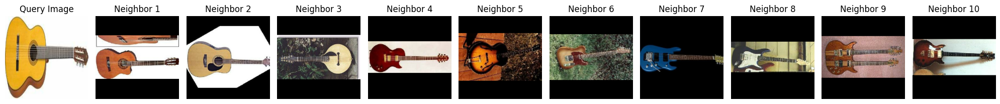

Nearest Neighbors indices: [[7171 3708 3273 4441 5733 8964 5685 6954 2937 6706]]
Distances: [[6.0758014  6.10474844 6.19732897 6.64522746 6.68824565 6.77152212
  6.82732556 6.86783407 7.06987239 7.12627924]]


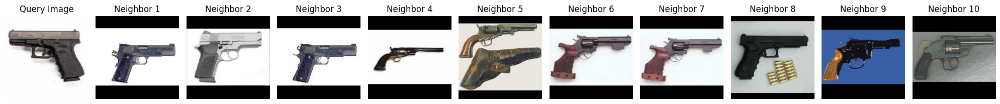

Nearest Neighbors indices: [[3965 2688 7444 6873 3962 8196 2339  524 1321 5189]]
Distances: [[7.68905575 7.9639889  8.44679472 8.45393037 8.47850474 8.54242479
  8.61739458 8.64513022 8.82597126 8.94099721]]


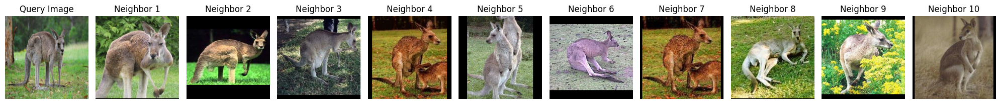

Nearest Neighbors indices: [[3361 4246 6435 4961 1603 7892 2884   10 4106 7626]]
Distances: [[7.1689544  7.49226211 7.63006619 7.7974487  7.86289    7.91916424
  7.92639757 8.45008145 8.78721298 8.8384848 ]]


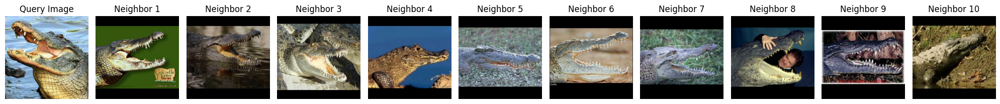

Nearest Neighbors indices: [[  18 6250 7005 5205  432 3321 3639 8687 8233 9021]]
Distances: [[12.12143966 12.20871636 12.33311254 12.34446451 12.41152898 12.47311093
  12.55084167 12.59304155 12.6018043  12.6041966 ]]


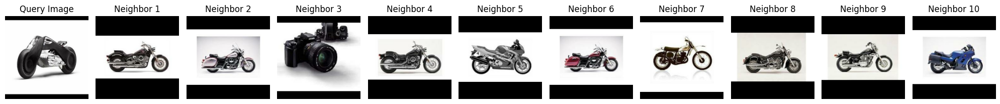

Nearest Neighbors indices: [[8845 2461 1687 2007 4283 8306 6832 1752 5811 5625]]
Distances: [[3.64084594 3.65870087 3.81786152 3.87151951 3.92153939 3.92720485
  3.9425842  3.9577107  4.09572342 4.10876823]]


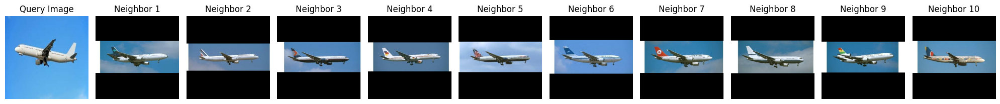

Nearest Neighbors indices: [[3497 1038 3892 1028  151 1003 2405 5397   22 8714]]
Distances: [[12.72513969 12.76832054 13.07269074 13.26213099 13.29490671 13.69247684
  13.95640766 13.96469922 14.04258564 14.10989289]]


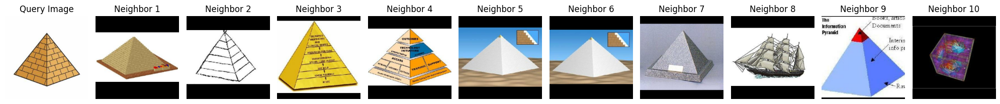

Nearest Neighbors indices: [[2962 6156 8813 8542 6830 8650  724 1130 5908 8067]]
Distances: [[11.12421257 11.47986111 11.80746889 11.83109687 11.90684313 12.13498051
  12.13842347 12.15092803 12.27727865 12.30188987]]


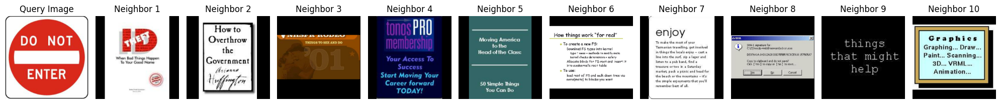

Nearest Neighbors indices: [[5439 1836 8170 2474 2095 6315 8208  393 3405 8191]]
Distances: [[ 7.60324433  7.82892798  8.2616225   9.21050536  9.34036585  9.49810036
   9.55979783  9.71121066  9.76548088 10.36560482]]


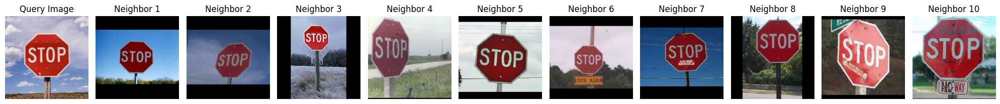

Nearest Neighbors indices: [[2323 3464 8820 1346 3328  710 5607 1253 3771 5033]]
Distances: [[7.35037879 7.79256178 7.99933028 8.11725608 8.12278315 8.21389604
  8.26103276 8.32721305 8.54486189 8.64163246]]


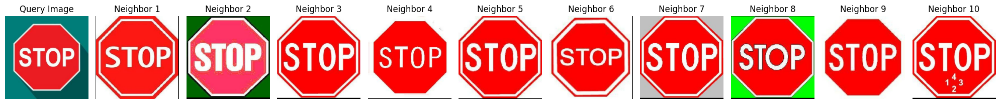

Nearest Neighbors indices: [[3337 4046 2904 2376 2563 8471 5508 5973 3641 3798]]
Distances: [[10.66786951 10.67612983 10.68103267 10.75983957 10.88194176 10.89736232
  10.95066789 11.2627624  11.31494894 11.44018607]]


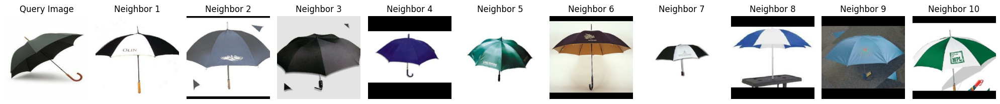

Nearest Neighbors indices: [[7820  717 6461 5226 7055 7539 6133 8204 8216 5171]]
Distances: [[9.25273481 9.32004131 9.3557801  9.4456001  9.69876795 9.72749446
  9.81418402 9.86355158 9.91285864 9.94710906]]


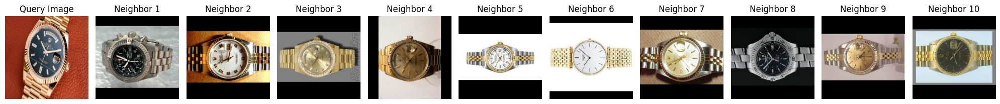

Nearest Neighbors indices: [[2016 4460 3527 1645  659   92 2720  507 5978 6062]]
Distances: [[5.81232289 5.83844487 5.98666814 6.00225452 6.02767568 6.03150163
  6.05475997 6.10635526 6.12141862 6.12838358]]


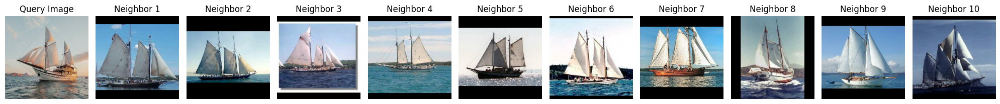

In [30]:
# Train the Nearest Neighbors model
nn = NearestNeighbors(n_neighbors=10, algorithm='ball_tree')
nn.fit(features)

def preprocess_image_2(image, label):
    image = tf.image.resize_with_pad(image, target_height=224, target_width=224)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

images_set = images_set.unbatch()

# Find nearest neighbors for each query image and visualize
for query_index, img in enumerate(images_set):
    query_image = img.numpy()
    distances, neighbor_indices = nn.kneighbors([new_images_features[query_index]])
    print("Nearest Neighbors indices:", neighbor_indices)
    print("Distances:", distances)
        
    # Get the actual images corresponding to the neighbor indices and resize them
    neighbor_images = []
    for index in neighbor_indices[0]:
        image, _ = next(iter(dataset_original.skip(index).take(1)))
        resized_image = preprocess_image_2(image, None)[0]
        neighbor_images.append(resized_image)

    # Define a function to visualize images
    def visualize_images(query_image, neighbor_images):
        plt.figure(figsize=(20, 5))
        plt.subplot(1, len(neighbor_images) + 1, 1)
        plt.imshow(query_image / 255)
        plt.title('Query Image')
        plt.axis('off')
        
        # Display images of nearest neighbors
        for i, image in enumerate(neighbor_images, start=2):
            plt.subplot(1, len(neighbor_images) + 1, i)
            plt.imshow(image)
            plt.title(f'Neighbor {i-1}')
            plt.axis('off')
        
        plt.tight_layout()
        plt.show()
    
    # Call the visualization function
    visualize_images(query_image, neighbor_images)